<a href="https://colab.research.google.com/github/Guiandreis/pneumonia_detection/blob/main/Pneumonia_CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## IMPORT KAGGLE DATASET AND EXTRACT

In [ ]:
#https://www.kaggle.com/datasets/paultimothymooney/chest-xray-pneumonia

In [ ]:
!pip install -q kaggle

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"guilhermerandreis","key":"993e325e5288d22c0d7d94e16ab76edd"}'}

In [ ]:
! mkdir ~/.kaggle/

In [ ]:
! cp kaggle.json ~/.kaggle/ 


In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
! kaggle datasets list

ref                                                             title                                               size  lastUpdated          downloadCount  voteCount  usabilityRating  
--------------------------------------------------------------  -------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
themrityunjaypathak/covid-cases-and-deaths-worldwide            Covid Cases and Deaths WorldWide                     8KB  2023-02-01 12:22:51           2790         73  1.0              
ahsan81/hotel-reservations-classification-dataset               Hotel Reservations Dataset                         480KB  2023-01-04 12:50:31          12000        382  1.0              
datascientistanna/customers-dataset                             Shop Customer Data                                  23KB  2023-02-07 18:42:21           2162         64  1.0              
themrityunjaypathak/most-subscribed-1000-youtube-channels       M

In [ ]:
!kaggle datasets download -d paultimothymooney/chest-xray-pneumonia

 99% 2.28G/2.29G [00:20<00:00, 124MB/s]
100% 2.29G/2.29G [00:20<00:00, 120MB/s]


In [ ]:
import zipfile

In [ ]:
path_to_zip_file = '/content/chest-xray-pneumonia.zip'
directory_to_extract_to = '/content/'
with zipfile.ZipFile(path_to_zip_file, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

# IMPORT PACKAGES

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import pandas as pd
import numpy as np
import glob
import matplotlib.pyplot as plt
import zipfile
import cv2
import random
import os
import shutil

In [ ]:
test = glob.glob('/content/chest_xray/train/*/*')
len(test)

5216

# PYTORCH

### IMPORTS

In [ ]:
#pip uninstall tb-nightly tensorboard && pip install tensorboard

In [ ]:
from collections import defaultdict

import copy

from urllib.request import urlretrieve

import cv2

import matplotlib.pyplot as plt

from tqdm import tqdm

import torch  
import torch.backends.cudnn as cudnn
import torch.nn as nn
import torch
import torchvision
import torchvision.models as models
from torch.utils.data import  DataLoader, Dataset, random_split
from torch.utils.tensorboard import SummaryWriter
%load_ext tensorboard

from mlxtend.plotting import plot_confusion_matrix
from sklearn.metrics import confusion_matrix, f1_score

cudnn.benchmark = True

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


### CONFIGURING DATA SET

In [ ]:
train_path = glob.glob('/content/chest_xray/train/*/*')
test_path = glob.glob('/content/chest_xray/test/*/*')
val_path = glob.glob('/content/chest_xray/val/*/*')
total_images_path = train_path + test_path + val_path

len(train_path), len(test_path), len(val_path), len(total_images_path)

(5216, 624, 16, 5856)

In [ ]:
train, val, test = random_split(
    total_images_path,[len(train_path) ,len(val_path),len(test_path)],
    generator = torch.Generator().manual_seed(42))

len(train), len(test), len(val), len(total_images_path)

(5216, 624, 16, 5856)

In [ ]:
class normalvspneumonia(Dataset):


    def __init__(self, images_filepaths, transform=None):

        self.images_filepaths = images_filepaths
        self.transform = transform

    def __len__(self):
        return len(self.images_filepaths)

    def __getitem__(self, idx):

        image_filepath = self.images_filepaths[idx]
        image = cv2.imread(image_filepath)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        if image_filepath.split('/')[-2] == "PNEUMONIA":
            label = 1.0
        else:
            label = 0.0
        
        if self.transform is not None:
            image = self.transform(image=image)["image"]

        image = np.transpose(image,(2,0,1)).astype(np.float32)
        image = torch.tensor(image,dtype = torch.float)

        return image, label

In [ ]:
IMG_SIZE = 224
val_transform = transforms.Compose(
    [       
        transforms.ToTensor(),
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ]
)

In [ ]:
val_dataset = normalvspneumonia(images_filepaths=val, transform=val_transform)

train_dataset = normalvspneumonia(images_filepaths=train, 
                                  transform=train_transform)

test_dataset = normalvspneumonia(images_filepaths=test, 
                                 transform=val_transform)

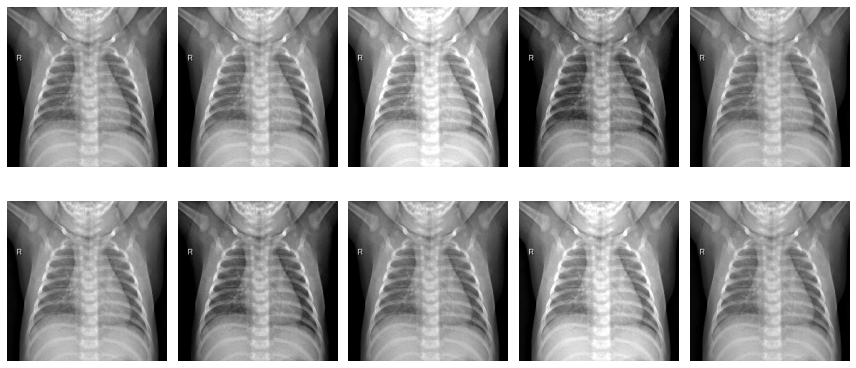

In [ ]:
### just in case of augumentation
#'''
def visualize_augmentations(dataset, idx=0, samples=10, cols=5):
  
    dataset = copy.deepcopy(dataset)
    dataset.transform = A.Compose(
        [t for t in dataset.transform if not isinstance(t, (A.Normalize))])
    
    rows = samples // cols
    figure, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(12, 6))
    for i in range(samples):
        image, _ = dataset[idx]
        ax.ravel()[i].imshow(image[0,:,:],cmap='gray')
        ax.ravel()[i].set_axis_off()
    plt.tight_layout()
    plt.show()

random.seed(42)
visualize_augmentations(train_dataset)
#'''

In [ ]:
image_datasets=  {'train': (train_dataset),
                 'validation': (val_dataset)
                 }

In [ ]:
batch_size =  8

dataloaders = {
    'train': DataLoader(train_dataset, batch_size=batch_size, shuffle=True),
    'validation':DataLoader(val_dataset, batch_size=batch_size, shuffle=True),
}
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True)

### CREATING AND TRAINING MODEL

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

In [ ]:

class classify(nn.Module):
    def __init__(self,num_classes=2):
        super(classify,self).__init__()
        
         
        self.conv1=nn.Conv2d(in_channels=3, out_channels=12, kernel_size=3, stride=1, padding=1)
        self.bn1=nn.BatchNorm2d(num_features=12)
        self.relu1=nn.ReLU()        
        self.pool=nn.MaxPool2d(kernel_size=2)
        self.conv2=nn.Conv2d(in_channels=12,out_channels=20,kernel_size=3,stride=1,padding=1)
        self.bn2=nn.BatchNorm2d(num_features=20)
        self.relu2=nn.ReLU()
        self.conv3=nn.Conv2d(in_channels=20,out_channels=32,kernel_size=3,stride=1,padding=1)
        self.bn3=nn.BatchNorm2d(num_features=32)
        self.relu3=nn.ReLU()
        self.fc=nn.Linear(in_features=32 * 112 * 112,out_features=num_classes)
        
        
        
        #Feed forwad function
        
    def forward(self,input):
        output=self.conv1(input)
        output=self.bn1(output)
        output=self.relu1(output)
        output=self.pool(output)
        output=self.conv2(output)
        output=self.bn2(output)
        output=self.relu2(output)
        output=self.conv3(output)
        output=self.bn3(output)
        output=self.relu3(output)            
        output=output.view(-1,32*112*112)
        output=self.fc(output)
            
        return output

In [ ]:
from torchsummary import summary

model_classify = classify()
model_classify.to(device)
print(model_classify)
summary(model_classify,(3,224,224))

classify(
  (conv1): Conv2d(3, 12, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(12, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(12, 20, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(20, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (conv3): Conv2d(20, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn3): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu3): ReLU()
  (fc): Linear(in_features=401408, out_features=2, bias=True)
)
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 12, 224, 224]             336
       BatchNorm2d-2         [-1, 12, 224, 224]              24
              ReLU-3         [-1,

In [ ]:
''' To check if the folder exist and if exist delete files in it'''
try: 
  dir_tensorboard = '/content/tensorboard/model/'
  for file in os.listdir(dir_tensorboard):
    os.remove(os.path.join(dir_tensorboard,file))
    shutil.rmtree(dir_tensorboard)

except:
  print('there are no files and no folder')
writer = SummaryWriter(f'/content/tensorboard/model')

In [ ]:
criterion = nn.CrossEntropyLoss()
optimizer_test = torch.optim.Adam(model_classify.parameters(), lr = 0.001)
scheduler_step = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_test, mode = 'min', factor = 1e-3, patience = 2 )

In [ ]:
def train_model(model, criterion, optimizer,
                path_to_save ,num_epochs=3,epoch_acc_max=0.75):
    step_writer_train = 0
    step_writer_val = 0
    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch+1, num_epochs))
        print('-' * 10)

        for phase in ['train', 'validation']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_corrects = 0

            for images, labels in dataloaders[phase]:
                images = images.to(device)
                labels = labels.type(torch.LongTensor)
                labels = labels.to(device)
                
                outputs = model(images)
                loss = criterion(outputs, labels)

                if phase == 'train':
                    optimizer.zero_grad()
                    loss.backward()
                    optimizer.step()

                _, preds = torch.max(outputs, 1)
                running_loss += loss.item() * images.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / len(image_datasets[phase])
            epoch_acc = running_corrects / len(image_datasets[phase])

            if phase == 'train':
              writer.add_scalar('train loss func',epoch_loss,
                                global_step = step_writer_train)
              writer.add_scalar('train acc',epoch_acc, 
                                global_step = step_writer_train)

              image_batch_train = torchvision.utils.make_grid(images)
              writer.add_image('image batch images train',image_batch_train, 
                               step_writer_train)

              step_writer_train+=1

            else:
              scheduler_step.step(epoch_loss)
              
              writer.add_scalar('val loss func',epoch_loss,
                                global_step = step_writer_val)
              writer.add_scalar('val acc',epoch_acc, 
                                global_step = step_writer_val)

              image_batch_train = torchvision.utils.make_grid(images)
              writer.add_image('image batch images val',image_batch_train, 
                               step_writer_train)

              step_writer_val+=1

              if epoch_acc > epoch_acc_max:
                epoch_acc_max = epoch_acc
                torch.save(model.state_dict(),path_to_save)


            print('{} loss: {:.4f}, acc: {:.4f}'.format(phase,
                                                        epoch_loss,
                                                        epoch_acc))
    return model

In [ ]:
path_to_save= '/content/gdrive/MyDrive/projects/pneumonia/model_pneumonia.pt'


model_trained = train_model(model_classify, criterion, 
                            optimizer_test,path_to_save, num_epochs=10)

Epoch 1/10
----------
train loss: 7.1651, acc: 0.8949
validation loss: 8.4240, acc: 0.8750
Epoch 2/10
----------
train loss: 2.0298, acc: 0.9373
validation loss: 1.6903, acc: 0.8750
Epoch 3/10
----------
train loss: 0.4826, acc: 0.9618
validation loss: 1.4229, acc: 0.8125
Epoch 4/10
----------
train loss: 0.1880, acc: 0.9737
validation loss: 0.6164, acc: 0.9375
Epoch 5/10
----------
train loss: 0.0914, acc: 0.9835
validation loss: 0.7552, acc: 0.8125
Epoch 6/10
----------
train loss: 0.0350, acc: 0.9910
validation loss: 0.8659, acc: 0.8750
Epoch 7/10
----------
train loss: 0.0804, acc: 0.9843
validation loss: 1.5170, acc: 0.8125
Epoch 8/10
----------
train loss: 0.0500, acc: 0.9889
validation loss: 1.4101, acc: 0.8125
Epoch 9/10
----------
train loss: 0.0549, acc: 0.9872
validation loss: 1.3713, acc: 0.8125
Epoch 10/10
----------
train loss: 0.0570, acc: 0.9883
validation loss: 1.3891, acc: 0.8125


In [ ]:
%tensorboard --logdir=/content/tensorboard

<IPython.core.display.Javascript object>

**TEST DATASET**

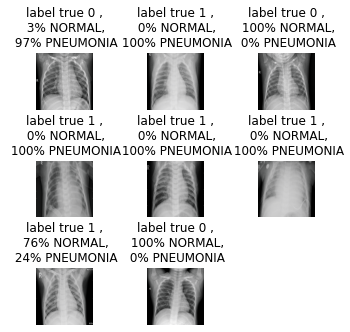

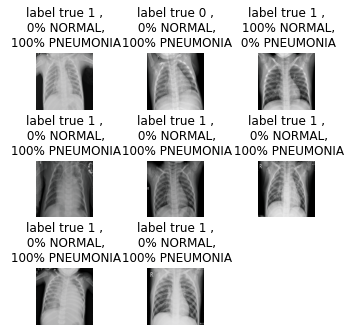

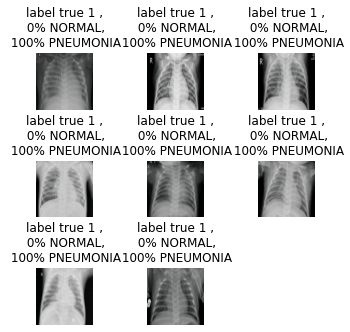

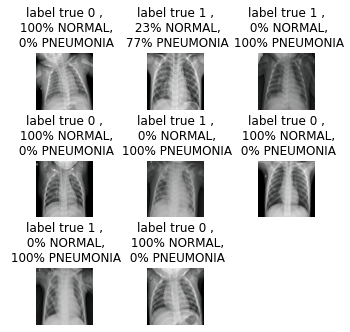

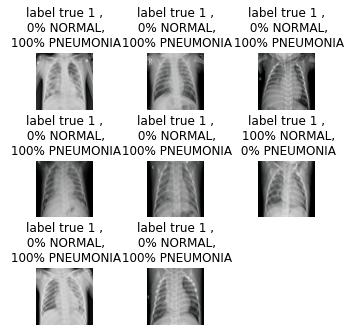

...

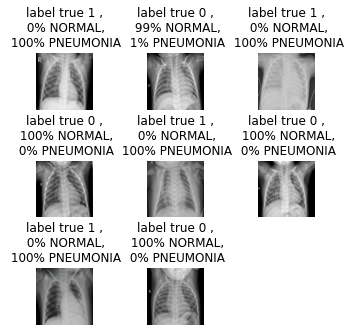

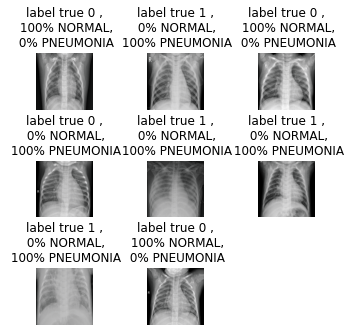

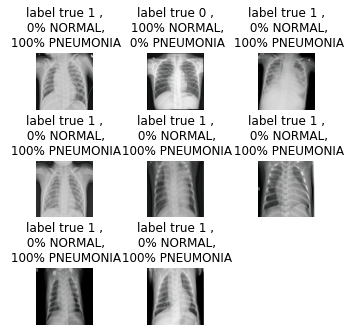

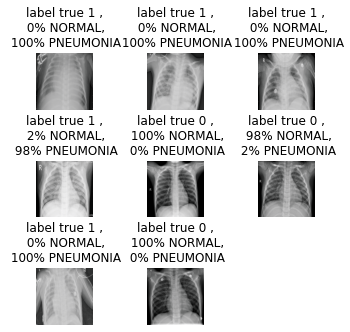

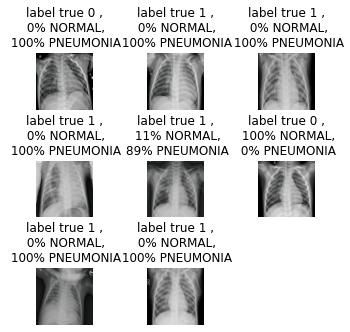

f1_result 0.9597315436241611


<Figure size 432x288 with 0 Axes>

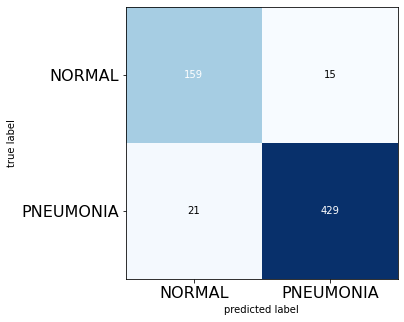

In [ ]:
def undo_norm(image):

  npimg = ((image * [0.229, 0.224, 0.225]) + [0.485, 0.456, 0.406])
  return npimg

label_numpy_list =[]
predics_numpy_list = []

for inputs, labels in test_dataloader:
  inputs = inputs.to(device)
  labels = labels.type(torch.LongTensor)
  labels = labels.to(device)
  predicted = model_trained(inputs)
  _,preds = torch.max(predicted, 1)

  label_numpy = labels.cpu().numpy().tolist()
  predics_numpy = preds.cpu().detach().numpy().tolist()

  pred_probs = torch.softmax(predicted, dim=1).cpu().data.numpy()

  plt.figure(figsize=(5,5))
  for i, img in enumerate(inputs):
      #ax = axs[i]
      ax = plt.subplot(3,3,i+1)
      plt.subplots_adjust( 
                    hspace=0.9,
                    right = 1,
                    #bottom = 0.5
                  
                    )
      ax.axis('off')

      if labels[i] == preds[i]:
        color = 'blue'

      else:
        color ='red'
      ax.set_title(
          "label true {:.0f} ,\n {:.0f}% NORMAL,\n {:.0f}% PNEUMONIA".
          format(
              labels[i],100*pred_probs[i,0],
              100*pred_probs[i,1],color = color))
      
      img = np.transpose(img.cpu().numpy(),(1,2,0))
      img = undo_norm(img)
      ax.imshow((img*255).astype(np.uint8))
  plt.show() 

  label_numpy_list = label_numpy_list + label_numpy
  predics_numpy_list = predics_numpy_list + predics_numpy

f1_result = f1_score(predics_numpy_list,label_numpy_list)
print('f1_result',f1_result)

cm  = confusion_matrix(label_numpy_list, predics_numpy_list)
plt.figure()
plot_confusion_matrix(cm,figsize=(5,5), hide_ticks=True)
plt.xticks(range(2), ['NORMAL','PNEUMONIA'], fontsize=16)
plt.yticks(range(2), ['NORMAL','PNEUMONIA'], fontsize=16)
plt.show()


### LOAD MAP IN CPU TO TEST

In [ ]:
device = torch.device('cpu')
device

device(type='cpu')

In [ ]:

class classify(nn.Module):
    def __init__(self,num_classes=2):
        super(classify,self).__init__()
        
         
        self.conv1=nn.Conv2d(in_channels=3, out_channels=12, kernel_size=3, stride=1, padding=1)
        self.bn1=nn.BatchNorm2d(num_features=12)
        self.relu1=nn.ReLU()        
        self.pool=nn.MaxPool2d(kernel_size=2)
        self.conv2=nn.Conv2d(in_channels=12,out_channels=20,kernel_size=3,stride=1,padding=1)
        self.bn2=nn.BatchNorm2d(num_features=20)
        self.relu2=nn.ReLU()
        self.conv3=nn.Conv2d(in_channels=20,out_channels=32,kernel_size=3,stride=1,padding=1)
        self.bn3=nn.BatchNorm2d(num_features=32)
        self.relu3=nn.ReLU()
        self.fc=nn.Linear(in_features=32 * 112 * 112,out_features=num_classes)
        
        
        
        #Feed forwad function
        
    def forward(self,input):
        output=self.conv1(input)
        output=self.bn1(output)
        output=self.relu1(output)
        output=self.pool(output)
        output=self.conv2(output)
        output=self.bn2(output)
        output=self.relu2(output)
        output=self.conv3(output)
        output=self.bn3(output)
        output=self.relu3(output)            
        output=output.view(-1,32*112*112)
        output=self.fc(output)
            
        return output

path = '/content/gdrive/MyDrive/projects/pneumonia/model_pneumonia.pt'
model = classify()
model.load_state_dict(torch.load(path, map_location = torch.device(device)))
model.to(device)
model.eval()

classify(
  (conv1): Conv2d(3, 12, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(12, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(12, 20, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(20, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (conv3): Conv2d(20, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn3): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu3): ReLU()
  (fc): Linear(in_features=401408, out_features=2, bias=True)
)

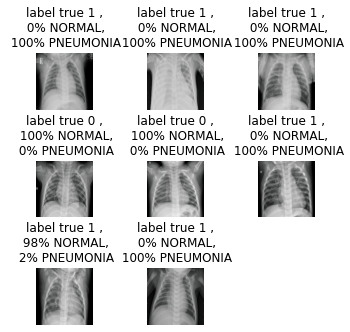

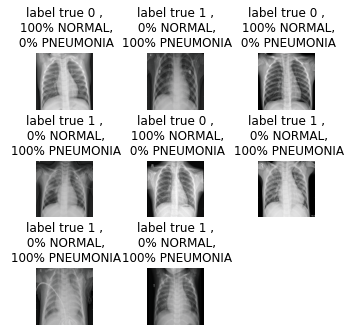

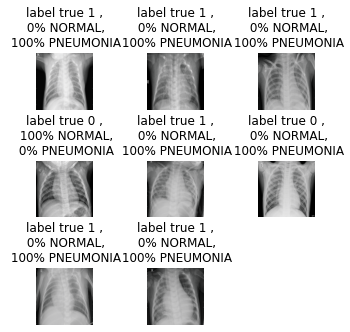

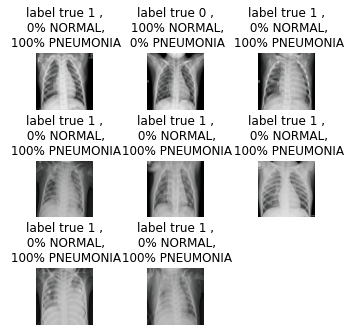

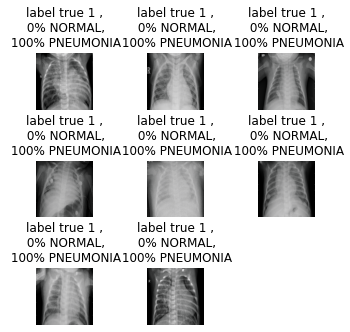

...

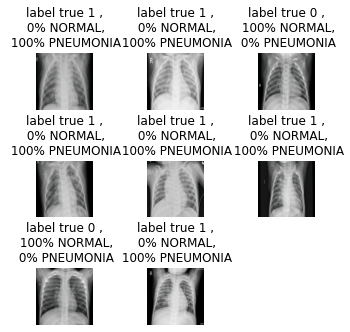

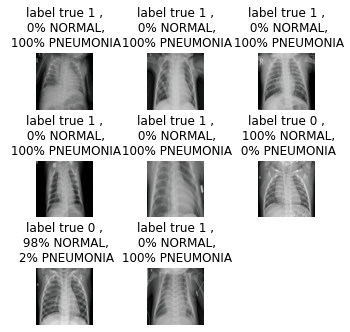

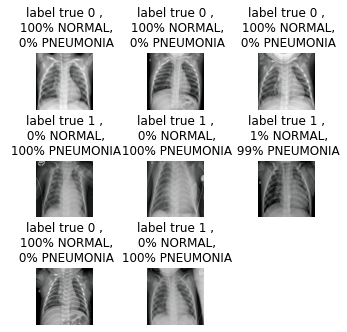

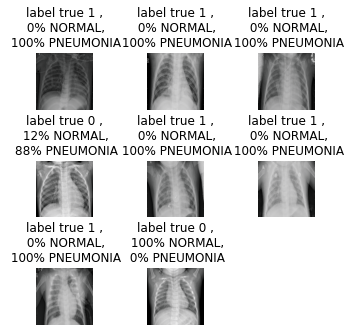

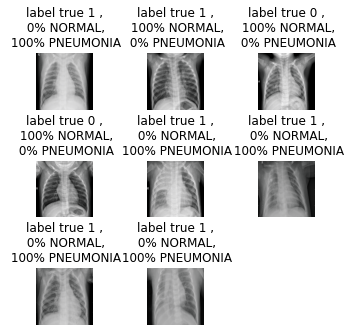

f1_result 0.9610678531701891


<Figure size 432x288 with 0 Axes>

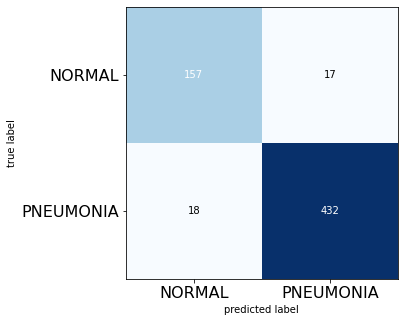

In [ ]:
def undo_norm(image):

  npimg = ((image * [0.229, 0.224, 0.225]) + [0.485, 0.456, 0.406])
  return npimg

label_numpy_list =[]
predics_numpy_list = []

for inputs, labels in test_dataloader:
  inputs = inputs.to(device)
  labels = labels.type(torch.LongTensor)
  labels = labels.to(device)
  predicted = model(inputs)
  _,preds = torch.max(predicted, 1)

  label_numpy = labels.cpu().numpy().tolist()
  predics_numpy = preds.cpu().detach().numpy().tolist()

  pred_probs = torch.softmax(predicted, dim=1).cpu().data.numpy()

  plt.figure(figsize=(5,5))
  for i, img in enumerate(inputs):
      #ax = axs[i]
      ax = plt.subplot(3,3,i+1)
      plt.subplots_adjust( 
                    hspace=0.9,
                    right = 1,
                    #bottom = 0.5
                  
                    )
      ax.axis('off')

      if labels[i] == preds[i]:
        color = 'b'

      else:
        color ='r'
      ax.set_title(
          "label true {:.0f} ,\n {:.0f}% NORMAL,\n {:.0f}% PNEUMONIA".
          format(
              labels[i],100*pred_probs[i,0],
              100*pred_probs[i,1],color = color))
      
      img = np.transpose(img.cpu().numpy(),(1,2,0))
      img = undo_norm(img)
      ax.imshow((img*255).astype(np.uint8))
  plt.show() 

  label_numpy_list = label_numpy_list + label_numpy
  predics_numpy_list = predics_numpy_list + predics_numpy

f1_result = f1_score(predics_numpy_list,label_numpy_list)
print('f1_result',f1_result)

cm  = confusion_matrix(label_numpy_list, predics_numpy_list)
plt.figure()
plot_confusion_matrix(cm,figsize=(5,5), hide_ticks=True)
plt.xticks(range(2), ['NORMAL','PNEUMONIA'], fontsize=16)
plt.yticks(range(2), ['NORMAL','PNEUMONIA'], fontsize=16)
plt.show()
